In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import cv2
from PIL import Image
import requests
import os

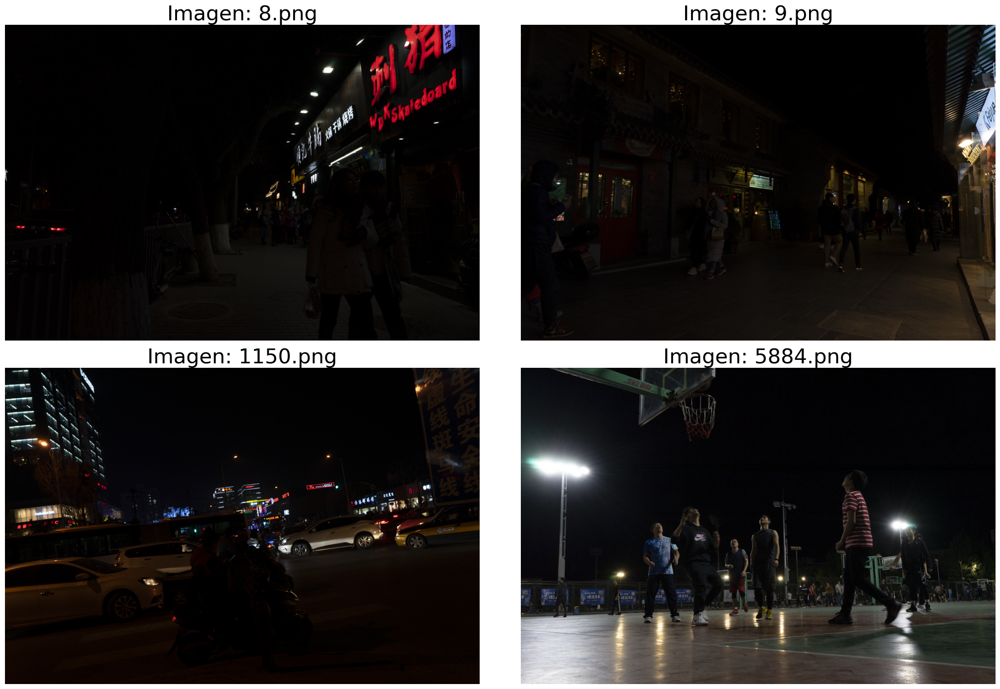

In [ ]:
image_paths = [
    "./Imagenes selecionadas/8.png",
    "./Imagenes selecionadas/9.png",
    "./Imagenes selecionadas/1150.png",
    "./Imagenes selecionadas/5884.png"
]

plt.figure(figsize=(21,14))  # Tamaño del gráfico

for i, path in enumerate(image_paths):
    image = cv2.imread(path)
    if image is None:
        print(f"Error: No se pudo cargar la imagen {path}. Verifica la ruta.")
        continue

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.subplot(2, 2, i + 1)
    plt.imshow(image_rgb)
    plt.axis('off')  # Quitar los ejes para que no se vean los números
    file_name = os.path.basename(path)  # Extraer el nombre del archivo
    plt.title(f"Imagen: {file_name}", fontsize=30)  # Título con el nombre del archivo

plt.tight_layout()
plt.show()

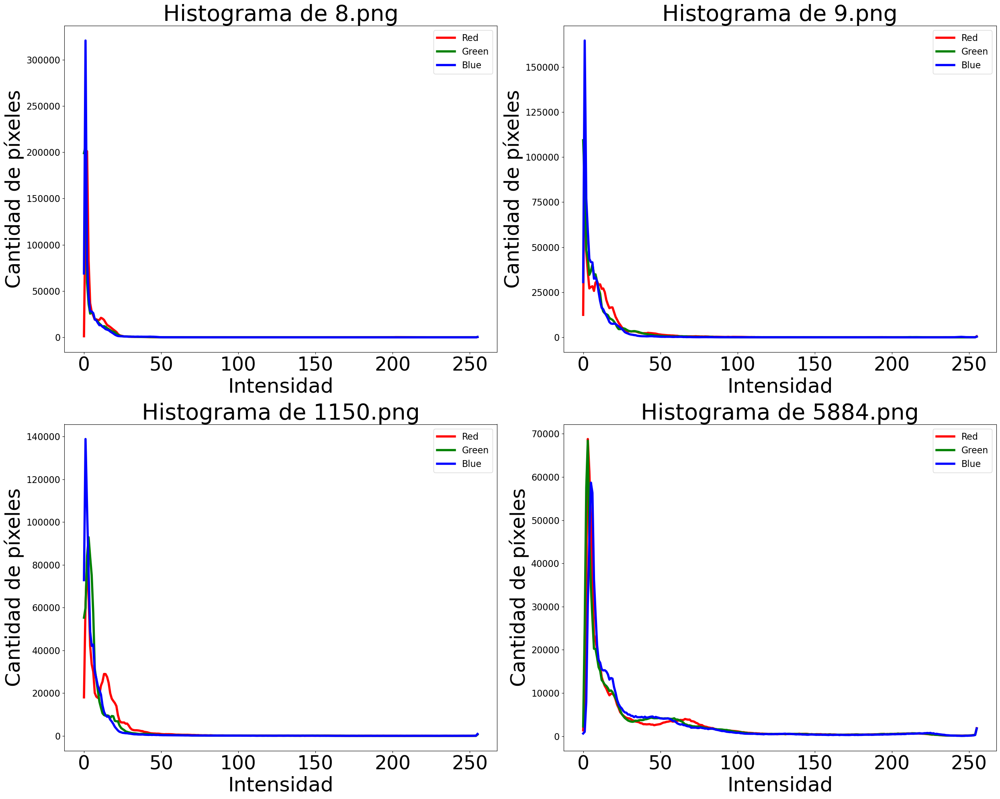

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Rutas de las imágenes
image_paths = [
    "./Imagenes selecionadas/8.png",
    "./Imagenes selecionadas/9.png",
    "./Imagenes selecionadas/1150.png",
    "./Imagenes selecionadas/5884.png"
]

# Inicializamos listas para almacenar los resultados
histograms = {'red': [], 'green': [], 'blue': []}
min_values = []
max_values = []

# Procesar cada imagen
for path in image_paths:
    # Cargar la imagen
    image = cv2.imread(path)  # Cargar en RGB
    if image is None:
        print(f"Error: No se pudo cargar la imagen {path}. Verifica la ruta.")
        continue

    # Separar los canales
    channels = cv2.split(image)  # Dividir en B, G, R
    channel_colors = ['blue', 'green', 'red']

    # Calcular histogramas para cada canal
    for channel, color in zip(channels, channel_colors):
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256])
        histograms[color].append(hist)

    # Calcular valores mínimo y máximo para la imagen completa
    min_val, max_val = np.min(image), np.max(image)
    min_values.append(min_val)
    max_values.append(max_val)

# Visualizar los histogramas y los valores
plt.figure(figsize=(25, 20))  # Hacer el tamaño del gráfico más grande

for i, path in enumerate(image_paths):
    plt.subplot(2, 2, i + 1)
    if i < len(min_values):  # Solo mostrar si se cargó correctamente
        for color in ['red', 'green', 'blue']:
            plt.plot(histograms[color][i], color=color, label=color.capitalize(), linewidth=4.0)  # linewidth aumentado

        file_name = os.path.basename(path)  # Extraer el nombre del archivo
        plt.title(f"Histograma de {file_name}", fontsize=40)  # Título más grande
        plt.xlabel("Intensidad", fontsize=36)  # Texto más grande en el eje x
        plt.ylabel("Cantidad de píxeles", fontsize=36)  # Texto más grande en el eje y
        plt.xticks(np.arange(0, 256, 50), fontsize=34)  # Aumentar tamaño de los números en el eje x
        plt.yticks(fontsize=16)  # Aumentar tamaño de los números en el eje y
        plt.legend(fontsize=16)  # Leyenda más grande
    else:
        plt.text(0.5, 0.5, "Imagen no cargada", ha="center", va="center", fontsize=16)
        plt.axis("off")

plt.tight_layout()
plt.show()


Dimensiones de la imagen: (720, 1080, 3)


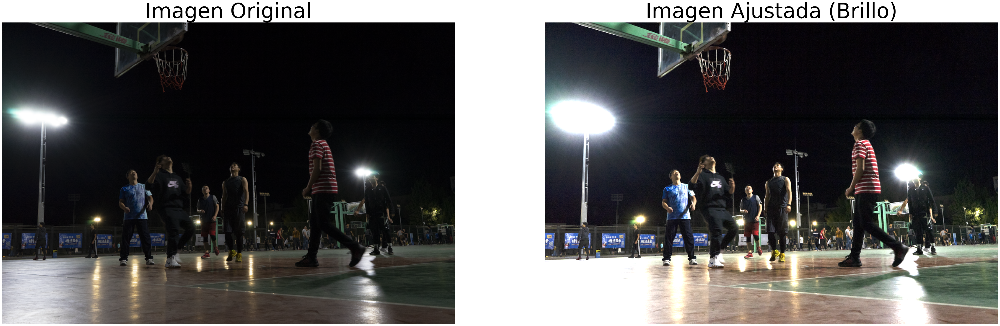

In [ ]:
image = cv2.imread("./Imagenes selecionadas/5884.png", cv2.IMREAD_UNCHANGED)

if image is None:
    print("Error: La imagen no se pudo cargar. Verifica la ruta y el formato.")
else:
    print(f"Dimensiones de la imagen: {image.shape}")

    factor = 2.5  #Brillo
    bright_image = np.clip(image * factor, 0, 255).astype(np.uint8)

    plt.figure(figsize=(60,60))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title("Imagen Original", fontsize=70)
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(bright_image, cv2.COLOR_BGR2RGB))
    plt.title("Imagen Ajustada (Brillo)", fontsize=70)
    plt.axis("off")

    plt.savefig("imagen_comparacion1.png")
    plt.show()

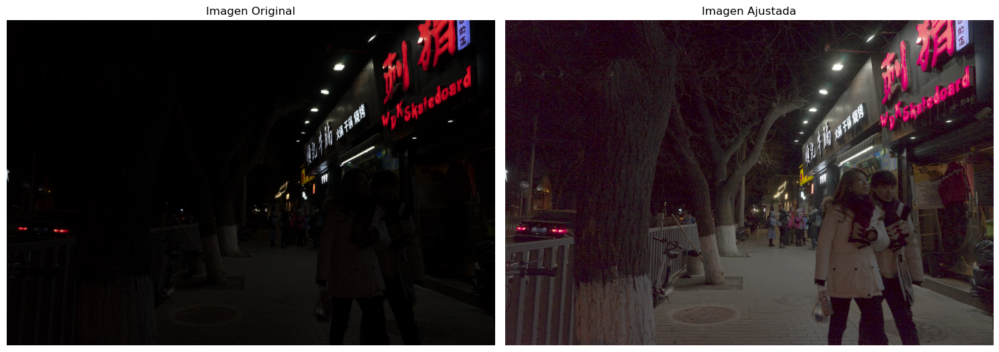

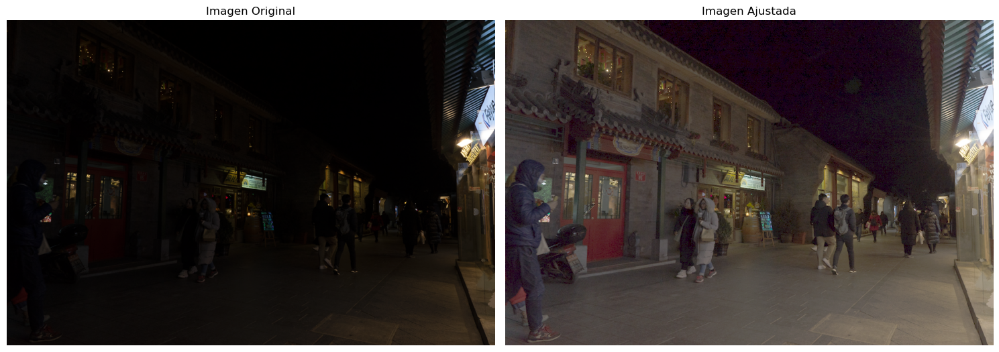

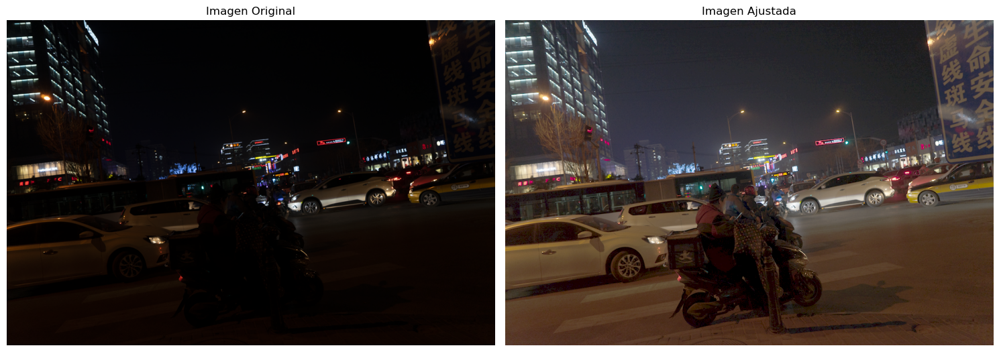

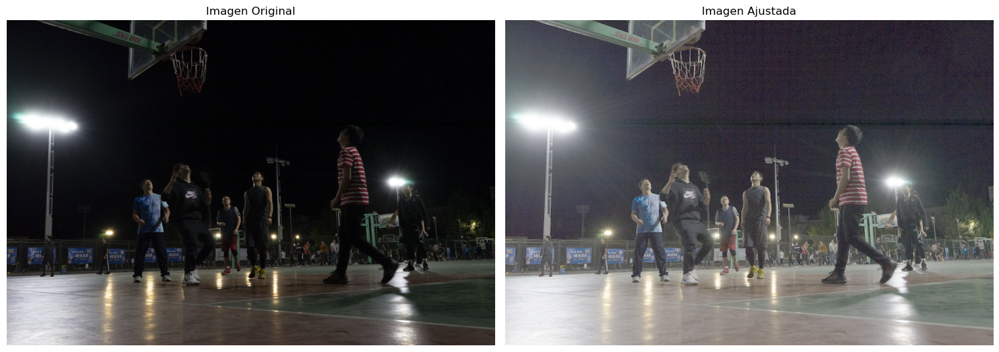

In [ ]:

image_paths = [
    "./Imagenes selecionadas/8.png",
    "./Imagenes selecionadas/9.png",
    "./Imagenes selecionadas/1150.png",
    "./Imagenes selecionadas/5884.png"
]

gamma_base = 2.5

for path in image_paths:
    image = cv2.imread(path, cv2.IMREAD_COLOR)  # Imagen en formato BGR
    if image is None:
        print(f"Error: No se pudo cargar la imagen {path}. Verifica la ruta.")
        continue
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)# Convertir la imagen de BGR a RGB para visualizar correctamente

    adjusted_image = np.zeros_like(image_rgb, dtype=np.uint8)# Crear una copia

    for channel in range(3):  # Canales 0: Red, 1: Green, 2: Blue
        channel_data = image_rgb[:, :, channel]# Seleccionar el canal

        # 1. Corrección Gamma
        normalized = channel_data / 255.0
        gamma = gamma_base  # Puede ajustarse dinámicamente si es necesario
        gamma_corrected = np.power(normalized, 1 / gamma) * 255
        gamma_corrected = gamma_corrected.astype(np.uint8)

        # 2. Máscara para zonas oscuras y ajuste de brillo
        threshold = 100  # Umbral para definir zonas oscuras
        mask = channel_data < threshold
        adjusted = channel_data.copy().astype(np.float32)
        adjusted[mask] *= 1.5  # Incrementar brillo en zonas oscuras
        adjusted = np.clip(adjusted, 0, 255).astype(np.uint8)

        final_adjusted = np.maximum(gamma_corrected, adjusted)
        adjusted_image[:, :, channel] = final_adjusted# Guardar

    plt.figure(figsize=(15, 10))

    plt.subplot(1, 2, 1)
    plt.imshow(image_rgb)
    plt.title("Imagen Original")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(adjusted_image)
    plt.title("Imagen Ajustada")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

Factor calculado: 1.74

Factor calculado: 2.83

Factor calculado: 2.80

Factor calculado: 1.20

Factor calculado: 1.49

Factor calculado: 1.80

Factor calculado: 1.21

Factor calculado: 1.70

Factor calculado: 1.98

Factor calculado: 0.53

Factor calculado: 0.53

Factor calculado: 0.54



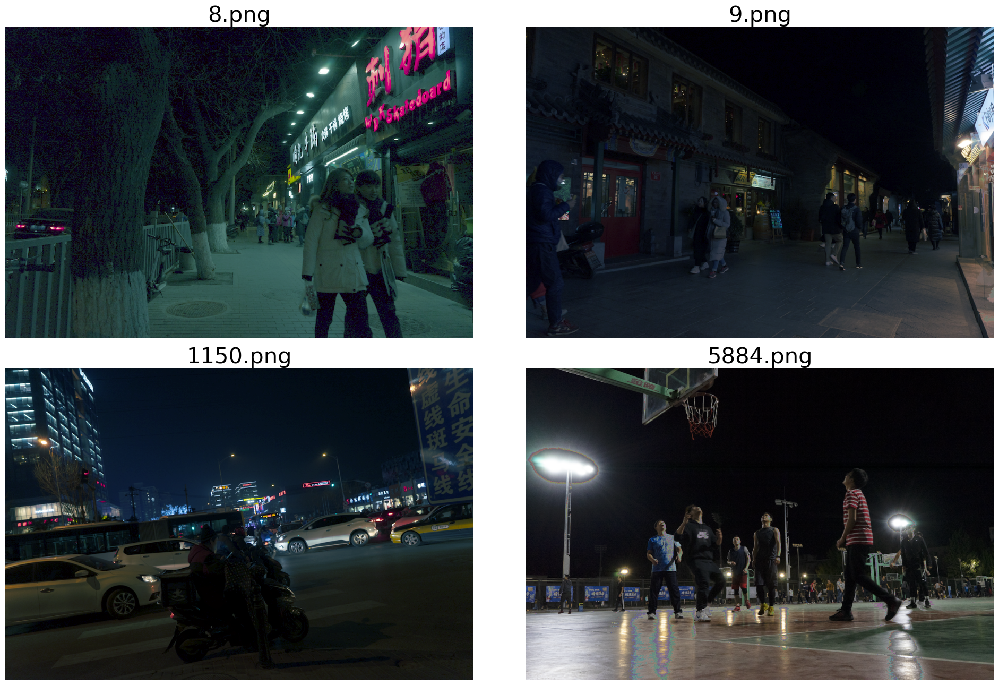

In [ ]:
# Rutas de las imágenes
image_paths = [
    "./Imagenes selecionadas/8.png",
    "./Imagenes selecionadas/9.png",
    "./Imagenes selecionadas/1150.png",
    "./Imagenes selecionadas/5884.png"
]

target_brightness = 20.0  # Intensidad objetivo
gamma_base = 2.0
processed_images = []

for path in image_paths:
    image = cv2.imread(path, cv2.IMREAD_COLOR)  # Imagen en formato BGR
    if image is None:
        print(f"Error: No se pudo cargar la imagen {path}. Verifica la ruta.")
        continue
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    adjusted_image = np.zeros_like(image_rgb, dtype=np.uint8)

    for channel in range(3):
        channel_data = image_rgb[:, :, channel]# Seleccionar el canal

        # 1. Corrección Gamma
        normalized = channel_data / 255.0
        current_mean = np.mean(channel_data)  # Promedio actual de brillo

        # Calcular el factor de ajuste
        factor = target_brightness / (current_mean +1)
        print(f"Factor calculado: {factor:.2f}\n")
        gamma = factor
        gamma_corrected = np.power(normalized, 1 / gamma) * 255
        gamma_corrected = gamma_corrected.astype(np.uint8)

        # 2. Máscara para zonas oscuras y ajuste de brillo
        threshold = 100  # Umbral para definir zonas oscuras
        mask = channel_data < threshold
        adjusted = channel_data.copy().astype(np.float32)
        adjusted[mask] *= 1.5  # Incrementar brillo en zonas oscuras
        adjusted = np.clip(adjusted, 0, 255).astype(np.uint8)

        final_adjusted = np.maximum(gamma_corrected, adjusted)
        adjusted_image[:, :, channel] = final_adjusted# Guardar

    processed_images.append((adjusted_image, os.path.basename(path)))# Guardar la imagen ajustada y su título (nombre del archivo)

num_images = len(processed_images)
cols = 2  # columnas
rows = (num_images + cols - 1) // cols  # filas

plt.figure(figsize=(20, 13))

for idx, (img, title) in enumerate(processed_images):
    plt.subplot(rows, cols, idx + 1)
    plt.imshow(img)
    plt.title(title, fontsize=30)
    plt.axis("off")

plt.tight_layout()
plt.savefig("imagen_comparacion2.png")
plt.show()

Factor calculado: 2.34

Factor calculado: 2.34

Factor calculado: 2.34

Factor calculado: 1.46

Factor calculado: 1.46

Factor calculado: 1.46

Factor calculado: 1.57

Factor calculado: 1.57

Factor calculado: 1.57

Factor calculado: 0.53

Factor calculado: 0.53

Factor calculado: 0.53



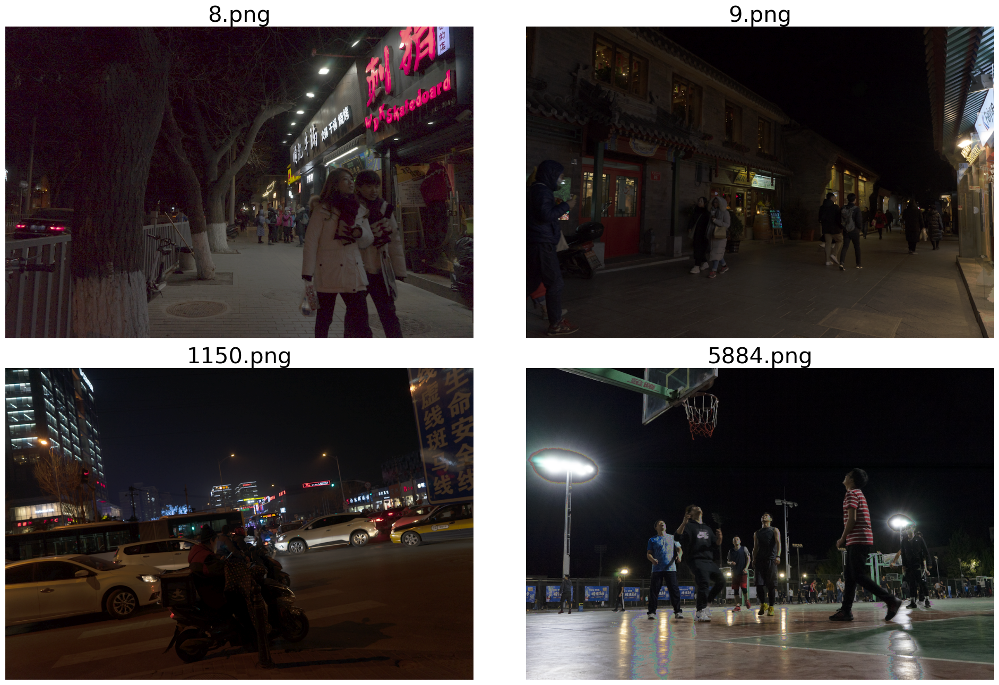

In [ ]:
image_paths = [
    "./Imagenes selecionadas/8.png",
    "./Imagenes selecionadas/9.png",
    "./Imagenes selecionadas/1150.png",
    "./Imagenes selecionadas/5884.png"
]

target_brightness = 20.0  # Intensidad objetivo
gamma_base = 2.0
processed_images = []

# Procesar cada imagen
for path in image_paths:
    # Cargar la imagen en RGB
    image = cv2.imread(path, cv2.IMREAD_COLOR)  # Imagen en formato BGR
    if image is None:
        print(f"Error: No se pudo cargar la imagen {path}. Verifica la ruta.")
        continue
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    adjusted_image = np.zeros_like(image_rgb, dtype=np.uint8)

    current_mean = np.mean(image_rgb)  # Promedio actual de brillo
    factor = target_brightness / (current_mean +1)
    for channel in range(3):  # Canales 0: Red, 1: Green, 2: Blue
        channel_data = image_rgb[:, :, channel]# Seleccionar el canal

        normalized = channel_data / 255.0
        print(f"Factor calculado: {factor:.2f}\n")

        gamma = factor  # Puede ajustarse dinámicamente si es necesario
        gamma_corrected = np.power(normalized, 1 / gamma) * 255
        gamma_corrected = gamma_corrected.astype(np.uint8)

        # 2. Máscara para zonas oscuras y ajuste de brillo
        threshold = 100  # Umbral para definir zonas oscuras
        mask = channel_data < threshold
        adjusted = channel_data.copy().astype(np.float32)
        adjusted[mask] *= 1.5  # Incrementar brillo en zonas oscuras
        adjusted = np.clip(adjusted, 0, 255).astype(np.uint8)

        final_adjusted = np.maximum(gamma_corrected, adjusted)
        adjusted_image[:, :, channel] = final_adjusted
    processed_images.append((adjusted_image, os.path.basename(path)))# Guardar la imagen ajustada y su nombre

num_images = len(processed_images)
cols = 2  #columnas
rows = (num_images + cols - 1) // cols  # filas

plt.figure(figsize=(20, 13))

for idx, (img, title) in enumerate(processed_images):
    plt.subplot(rows, cols, idx + 1)
    plt.imshow(img)
    plt.title(title, fontsize=30)
    plt.axis("off")

plt.tight_layout()
plt.savefig("imagen_comparacion3.png")
plt.show()

Imagen: 8.png
Brillo actual (promedio): 7.56, Máximo: 255
Factor calculado: 16.94



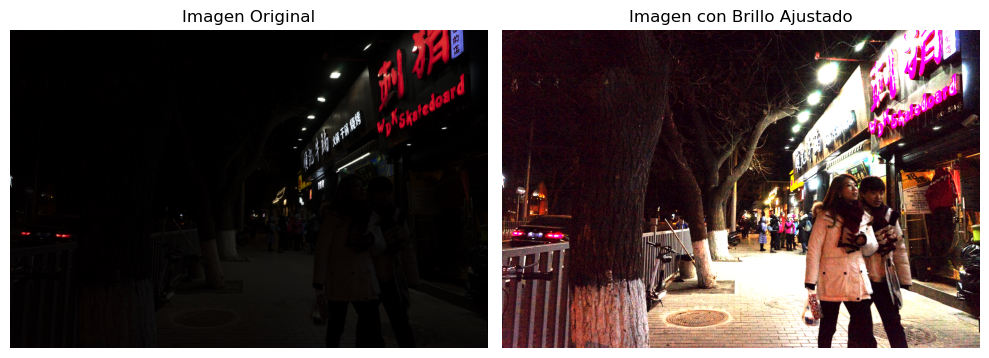

Imagen: 9.png
Brillo actual (promedio): 12.69, Máximo: 255
Factor calculado: 10.08



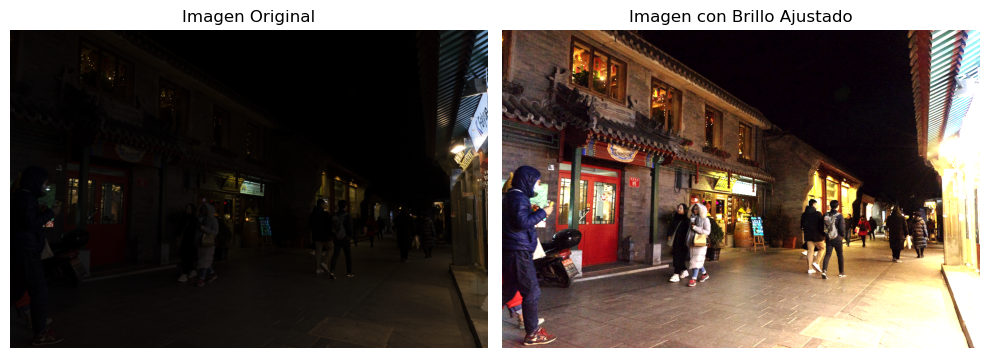

Imagen: 20.png
Brillo actual (promedio): 9.95, Máximo: 255
Factor calculado: 12.86



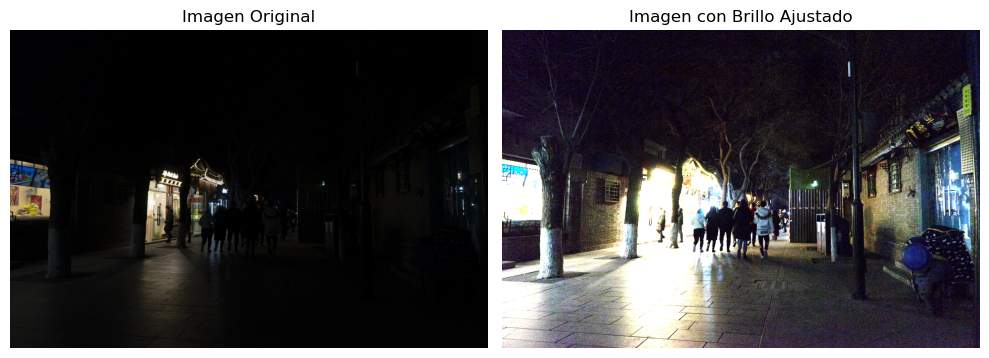

Imagen: 29.png
Brillo actual (promedio): 14.51, Máximo: 255
Factor calculado: 8.82



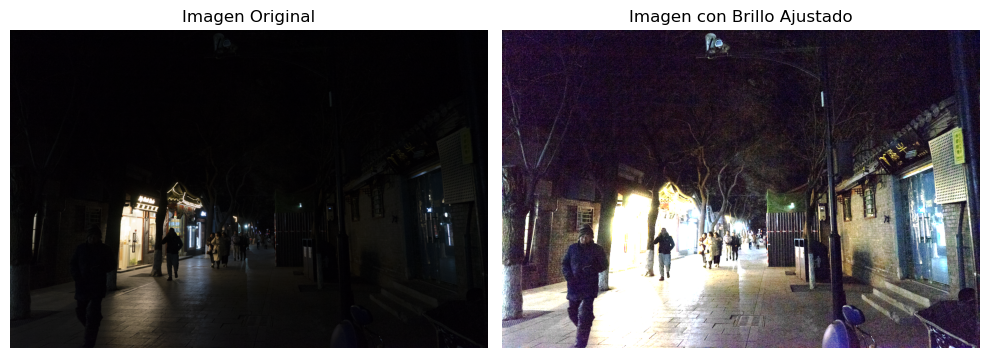

In [ ]:
# Zonas quemadas
image_paths = [
    "./Imagenes selecionadas/8.png",
    "./Imagenes selecionadas/9.png",
    "./Imagenes selecionadas/20.png",
    "./Imagenes selecionadas/29.png"
]

target_brightness = 128  # Intensidad objetivo

for path in image_paths:
    image = cv2.imread(path)
    if image is None:
        print(f"Error: No se pudo cargar la imagen {path}. Verifica la ruta.")
        continue
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convertir a RGB

    current_mean = np.mean(image)  # Promedio actual de brillo
    current_max = np.max(image)   # Máximo actual de brillo
    factor = target_brightness / current_mean
    print(f"Imagen: {os.path.basename(path)}")
    print(f"Brillo actual (promedio): {current_mean:.2f}, Máximo: {current_max}")
    print(f"Factor calculado: {factor:.2f}\n")

    adjusted_image = np.clip(image.astype(np.float32) * factor, 0, 255).astype(np.uint8)

    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title("Imagen Original")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(adjusted_image)
    plt.title("Imagen con Brillo Ajustado")
    plt.axis("off")

    plt.tight_layout()
    plt.show()